<h1>Importing the libraries</h1>

In [ ]:
from google.colab import drive
drive.mount("/content/drive")

Mounted at /content/drive


In [ ]:
!pip install -U --no-cache-dir gdown --pre

download_ids = ['1SkZn3Lw6Znsct07SeYsA-VyILjeeueEs']

for id in download_ids:
  print("Attept download from", id)
  response = !gdown --id $id --output deepfake_data.tar.gz
  if response[0] == 'Downloading...':
    break
  else:
    continue

!unzip '/content/deepfake_data.tar.gz'

In [ ]:
# Import the libraries
import numpy as np
import keras
from keras import backend as K
from keras.layers.core import Dense, Dropout
from keras.optimizers import Adam
from keras.preprocessing.image import ImageDataGenerator
from keras.models import Model
from keras.callbacks import ReduceLROnPlateau, ModelCheckpoint
from sklearn.metrics import confusion_matrix
import itertools
import matplotlib.pyplot as plt

In [ ]:
# The paths for the training and validation images
train_path = '/content/categorical train test splitter/categorical train'
valid_path = '/content/categorical train test splitter/categorical test'


#number of images in every forward/backwards pass
train_batch_size = 10
val_batch_size = 10
#dimensions of the image that will be inputed into the network (224x224)
image_size = 224


# Set up generators
train_batches = ImageDataGenerator(
    preprocessing_function= \
        keras.applications.mobilenet.preprocess_input).flow_from_directory(
    train_path, #pointing to the path where the data is stored
    target_size=(image_size, image_size), #the target size of the image output
    batch_size=train_batch_size) #size of the batches

valid_batches = ImageDataGenerator(
    preprocessing_function= \
        keras.applications.mobilenet.preprocess_input).flow_from_directory(
    valid_path,
    target_size=(image_size, image_size),
    batch_size=val_batch_size)

test_batches = ImageDataGenerator(
    preprocessing_function= \
        keras.applications.mobilenet.preprocess_input).flow_from_directory(
    valid_path,
    target_size=(image_size, image_size),
    batch_size=val_batch_size,
    shuffle=False)
        


# Declare a few useful values

#number of images in the training set
num_train_samples = 7916
#number of images in the evaluation set
num_val_samples = 2099

# Declare how many steps are needed in an iteration
train_steps = np.ceil(num_train_samples / train_batch_size)
val_steps = np.ceil(num_val_samples / val_batch_size)

Found 7916 images belonging to 7 classes.
Found 2099 images belonging to 7 classes.
Found 2099 images belonging to 7 classes.


<h1>Plotting dataset</h1>

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

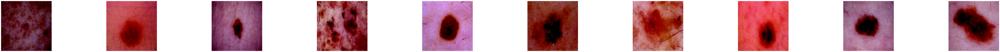

In [ ]:
def plots(ims, fig=(120,6) , rows=1, interp=False,titles=None):
#     if type(ims[0]) is np.ndarray:
#         ims=np.array(ims).astype(np.uint8)
#     if (ims.shape[-1]!=3):
#         ims=ims.transpose((0,2,3,1))
    f=plt.figure(figsize=fig)
    cols=len(ims)//rows if len(ims)%2==0 else len(ims)//rows+1
    for i in range(len(ims)):
        sp=f.add_subplot(rows,cols,i+1)
        sp.axis('off')
        if titles is not None:
            sp.set_title(titles[i],fontsize=16)
        plt.imshow(ims[i] , interpolation=None if interp else 'none')
        if i>10:
            break

x,y=next(train_batches)
plots(ims=x)

In [ ]:
# Create a MobileNet model
mobile = keras.applications.mobilenet.MobileNet()

# Modify the model
# Choose the 6th layer from the last
x = mobile.layers[-6].output

# Add a dropout and dense layer for predictions
x = Dropout(0.25)(x)
predictions = Dense(7, activation='softmax')(x)

# Create a new model with the new outputs
model = Model(inputs=mobile.input, outputs=predictions)

# Prevent everything except the last 23 layers from being trained
for layer in model.layers[:-23]:
    layer.trainable = False

17227776/17225924 [==============================] - 0s 0us/step


In [ ]:
# Define Top2 and Top3 Accuracy
from keras.metrics import categorical_accuracy, top_k_categorical_accuracy

def top_3_accuracy(y_true, y_pred):
    return top_k_categorical_accuracy(y_true, y_pred, k=3)

def top_2_accuracy(y_true, y_pred):
    return top_k_categorical_accuracy(y_true, y_pred, k=2)

def top_1_accuracy(y_true, y_pred):
    return top_k_categorical_accuracy(y_true, y_pred, k=1)

# Compile the model
model.compile(Adam(lr=0.01), loss='categorical_crossentropy', metrics=[categorical_accuracy, top_2_accuracy, top_3_accuracy])

# Add weights to make the model more sensitive to melanoma
class_weights={
    0: 1.0,  # akiec
    1: 1.0,  # bcc
    2: 1.0,  # bkl
    3: 1.0,  # df
    4: 3.0,  # mel
    5: 1.0,  # nv
    6: 1.0,  # vasc
}

In [ ]:
import time
from keras.callbacks import TensorBoard
filepath = "/content/drive/MyDrive/00 thesis/data set/hum1000/thesis data asif/model/unknown/weight/weights-improvement-{epoch:02d}-{val_categorical_accuracy:.2f}.hdf5"
Name = "tf-SeNet50_cs230_{}".format(int(time.time()))
tensorboard= TensorBoard(log_dir='/content/drive/MyDrive/00 thesis/data set/hum1000/thesis data asif/model/unknown/logFile/{}'.format(Name))


In [ ]:
# Declare a checkpoint to save the best version of the model
checkpoint = ModelCheckpoint(filepath, monitor='val_categorical_accuracy', verbose=1,
                             save_best_only=True, mode='max')

# Reduce the learning rate as the learning stagnates
reduce_lr = ReduceLROnPlateau(monitor='val_categorical_accuracy', factor=0.5, patience=2,
                              verbose=1, mode='max', min_lr=0.00001)

callbacks_list = [checkpoint, reduce_lr,tensorboard]

# Fit the model
history = model.fit_generator(train_batches,
                              steps_per_epoch=train_steps,
                              class_weight=class_weights,
                              validation_data=valid_batches,
                              validation_steps=val_steps,
                              epochs=50,
                              verbose=1,
                              callbacks=callbacks_list)

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/training.py:1844: UserWarning: `Model.fit_generator` is deprecated and will be removed in a future version. Please use `Model.fit`, which supports generators.
  warnings.warn('`Model.fit_generator` is deprecated and '


Epoch 1/50
792/792 [==============================] - 134s 126ms/step - loss: 1.6232 - categorical_accuracy: 0.6096 - top_2_accuracy: 0.7939 - top_3_accuracy: 0.8815 - val_loss: 1.0125 - val_categorical_accuracy: 0.7122 - val_top_2_accuracy: 0.8261 - val_top_3_accuracy: 0.8985

Epoch 00001: val_categorical_accuracy improved from -inf to 0.71224, saving model to /content/drive/MyDrive/00 thesis/data set/hum1000/thesis data asif/model/unknown/weight/weights-improvement-01-0.71.hdf5
Epoch 2/50
792/792 [==============================] - 97s 122ms/step - loss: 1.0183 - categorical_accuracy: 0.7026 - top_2_accuracy: 0.8623 - top_3_accuracy: 0.9396 - val_loss: 0.7955 - val_categorical_accuracy: 0.7356 - val_top_2_accuracy: 0.8523 - val_top_3_accuracy: 0.9290

Epoch 00002: val_categorical_accuracy improved from 0.71224 to 0.73559, saving model to /content/drive/MyDrive/00 thesis/data set/hum1000/thesis data asif/model/unknown/weight/weights-improvement-02-0.74.hdf5
Epoch 3/50
792/792 [========

In [ ]:
from sklearn.metrics import classification_report, confusion_matrix
Y_pred = model.predict_generator(valid_batches) #2099=>> total image , 11==> batch size
y_pred = np.argmax(Y_pred, axis=1)
print('Confusion Matrix')
print(confusion_matrix(valid_batches.classes, y_pred))
print('Classification Report')
target_names = 'akiec bcc bkl df mel nv vasc'.split()
print(classification_report(valid_batches.classes, y_pred, target_names=target_names))

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/training.py:1905: UserWarning: `Model.predict_generator` is deprecated and will be removed in a future version. Please use `Model.predict`, which supports generators.
  warnings.warn('`Model.predict_generator` is deprecated and '


Confusion Matrix
[[  1   7   6   4   6  44   0]
 [  4   5   8   1  11  78   0]
 [  7   9  26   4  21 160   3]
 [  1   0   5   1   2  14   1]
 [  9  13  23   3  25 155   5]
 [ 62  80 145  10 153 937  21]
 [  1   2   2   0   4  19   1]]
Classification Report
              precision    recall  f1-score   support

       akiec       0.01      0.01      0.01        68
         bcc       0.04      0.05      0.04       107
         bkl       0.12      0.11      0.12       230
          df       0.04      0.04      0.04        24
         mel       0.11      0.11      0.11       233
          nv       0.67      0.67      0.67      1408
        vasc       0.03      0.03      0.03        29

    accuracy                           0.47      2099
   macro avg       0.15      0.15      0.15      2099
weighted avg       0.48      0.47      0.48      2099



In [ ]:
confusion_matrix(valid_batches.classes, y_pred)

array([[  1,   7,   6,   4,   6,  44,   0],
       [  4,   5,   8,   1,  11,  78,   0],
       [  7,   9,  26,   4,  21, 160,   3],
       [  1,   0,   5,   1,   2,  14,   1],
       [  9,  13,  23,   3,  25, 155,   5],
       [ 62,  80, 145,  10, 153, 937,  21],
       [  1,   2,   2,   0,   4,  19,   1]])

In [ ]:
%tensorBoard --logdir="/content/drive/MyDrive/00 thesis/data set/hum1000/thesis data asif/model/unknown/logFile"

UsageError: Line magic function `%tensorBoard` not found.


In [ ]:
TensorBoard(log_dir='/content/drive/MyDrive/00 thesis/data set/hum1000/thesis data asif/model/unknown/logFile')

In [ ]:
%tensorboard --logdir="/content/drive/MyDrive/00thesis/data set/hum1000/thesis data asif/model/unknown/logFile/tf-SeNet50_cs230_1618511875"

Output hidden; open in https://colab.research.google.com to view.